In [1]:
%reload_ext autoreload
%autoreload 2
%matplotlib inline

In [2]:
import warnings
warnings.filterwarnings("ignore", category=UserWarning)

In [3]:
import numpy as np
from tqdm import tqdm
from pathlib import Path
import openslide
import pandas as pd
import pickle

In [4]:
from fastai.callbacks.csv_logger import CSVLogger

In [5]:
from object_detection_fastai.helper.object_detection_helper import *
from object_detection_fastai.helper.wsi_loader import *
from object_detection_fastai.loss.RetinaNetFocalLoss import RetinaNetFocalLoss
from object_detection_fastai.models.RetinaNet import RetinaNet
from object_detection_fastai.callbacks.callbacks import BBLossMetrics, BBMetrics, PascalVOCMetric, PascalVOCMetricByDistance

In [6]:
slides_train = list(set(['BAL Promyk Spray 4.svs',
                         'BAL AIA Blickfang Luft.svs']))

slides_val = list(set(['BAL 1 Spray 2.svs', 
                         'BAL Booker Spray 3.svs',
                         'BAL Bubi Spray 1.svs', 
                         'BAL cent blue Luft 2.svs']))

labels = ['Mastzellen', "Makrophagen", "Neutrophile", "Eosinophile", "Lymohozyten"]

In [7]:
experiment_name = "Asthma-L0-Screening"

In [8]:
annotations_path = Path("../Statistics/Asthma_Annotations.pkl")
annotations = pd.read_pickle(annotations_path)

annotations = annotations[annotations["class"].isin(labels)]
annotations_train = annotations[annotations["image_name"].isin(slides_train)]
annotations_val = annotations[annotations["image_name"].isin(slides_val)]
annotations_train.head()

,id,image_id,image_name,image_set,class,vector,unique_identifier,user_id,deleted,last_editor
21105,140917,226,BAL Promyk Spray 4.svs,14,Makrophagen,"{'x1': 14371, 'x2': 14435, 'y1': 14738, 'y2': ...",2c2f610e-f4f7-4e05-8236-ffa28418550d,10,False,None
21106,140918,226,BAL Promyk Spray 4.svs,14,Makrophagen,"{'x1': 14066, 'x2': 14152, 'y1': 14692, 'y2': ...",bcf159fc-2a41-4a69-a4cd-9b48da8fc663,10,False,None
21107,140919,226,BAL Promyk Spray 4.svs,14,Makrophagen,"{'x1': 14377, 'x2': 14451, 'y1': 14646, 'y2': ...",f5e247d5-9c38-4e22-9329-56805024cf83,10,False,None
21108,140920,226,BAL Promyk Spray 4.svs,14,Makrophagen,"{'x1': 14304, 'x2': 14384, 'y1': 14600, 'y2': ...",f68910d0-eb8f-4715-ad8d-accd060efff1,10,False,None
21109,140921,226,BAL Promyk Spray 4.svs,14,Makrophagen,"{'x1': 14318, 'x2': 14402, 'y1': 14544, 'y2': ...",013f3fc1-b603-41ce-8357-e446db2c9a14,10,False,None


In [9]:
annotations["width"] = [vector["x2"] - vector["x1"] for vector in annotations["vector"]]
annotations["height"] = [vector["y2"] - vector["y1"] for vector in annotations["vector"]]
annotations["scale"] = annotations["width"] / annotations["height"]

<AxesSubplot:xlabel='width', ylabel='height'>

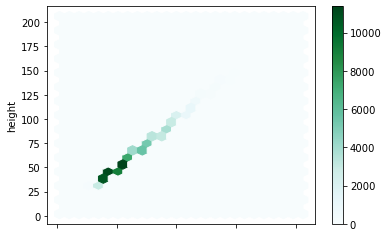

In [10]:
annotations.plot.hexbin(x='width', y='height', gridsize=25) #C='scale', 

In [11]:
slides_path = Path("../Slides")
files = {slide.name: slide for slide in slides_path.rglob("*.svs") if slide.name in slides_train + slides_val}
files

{'BAL 1 Spray 2.svs': WindowsPath('../Slides/BAL 1 Spray 2.svs'),
 'BAL AIA Blickfang Luft.svs': WindowsPath('../Slides/BAL AIA Blickfang Luft.svs'),
 'BAL Booker Spray 3.svs': WindowsPath('../Slides/BAL Booker Spray 3.svs'),
 'BAL Bubi Spray 1.svs': WindowsPath('../Slides/BAL Bubi Spray 1.svs'),
 'BAL cent blue Luft 2.svs': WindowsPath('../Slides/BAL cent blue Luft 2.svs'),
 'BAL Promyk Spray 4.svs': WindowsPath('../Slides/BAL Promyk Spray 4.svs')}

In [12]:
with open('../Statistics/Screening.pickle', 'rb') as handle:
    screening_modes = pickle.load(handle)

In [13]:
def filterAnnotations(image_name, xmin, ymin, screening_modes, patch_x:int = 1024, patch_y:int = 1024):
    
    screening = screening_modes[image_name]
    tiles = screening["screening_tiles"]  
    
    xmin, ymin = max(1, int(xmin - patch_x / 2)), max(1, int(ymin - patch_y / 2))
    
    x_step = int(np.ceil(xmin / screening["x_resolution"]))
    y_step = int(np.ceil(ymin / screening["y_resolution"]))
    
    return tiles[str((y_step * screening["x_steps"]) + x_step)]['Screened']

In [14]:
annotations_train["border"] = annotations_train.apply(lambda x: filterAnnotations(x["image_name"], x["vector"]["x1"], x["vector"]["y1"], screening_modes), axis=1)
annotations_val["border"] = annotations_val.apply(lambda x: filterAnnotations(x["image_name"], x["vector"]["x1"], x["vector"]["y1"], screening_modes), axis=1)
annotations_val.head()

d:\anaconda3\envs\eiph_wsi\lib\site-packages\ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.
d:\anaconda3\envs\eiph_wsi\lib\site-packages\ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


,id,image_id,image_name,image_set,class,vector,unique_identifier,user_id,deleted,last_editor,border
0,172441,221,BAL 1 Spray 2.svs,14,Makrophagen,"{'x1': 13612, 'x2': 13666, 'y1': 12371, 'y2': ...",a268b46f-e13f-480e-b96d-c7900790ad5f,10,False,None,False
1,172442,221,BAL 1 Spray 2.svs,14,Makrophagen,"{'x1': 13562, 'x2': 13618, 'y1': 12437, 'y2': ...",e8d67efd-0baf-4f78-ad73-b8f77422b826,10,False,None,False
2,172443,221,BAL 1 Spray 2.svs,14,Makrophagen,"{'x1': 13482, 'x2': 13546, 'y1': 12458, 'y2': ...",55aa3d51-7f30-43a0-83ef-d9acc74d9a21,10,False,None,False
3,172444,221,BAL 1 Spray 2.svs,14,Makrophagen,"{'x1': 13471, 'x2': 13533, 'y1': 12281, 'y2': ...",8f259e8f-119b-44de-8a90-2c53e7ee0e60,10,False,None,False
4,172446,221,BAL 1 Spray 2.svs,14,Makrophagen,"{'x1': 13591, 'x2': 13673, 'y1': 12204, 'y2': ...",052b3f5a-f6f6-4b0d-a134-9f4797601dc4,10,False,None,False


In [15]:
class SlideContainerWithScreening(SlideContainer):

    def get_new_train_coordinates(self):
        # use passed sampling method
        if callable(self.sample_func):
            return self.sample_func(self.y, **{"classes": self.classes, "size": self.shape,
                                               "level_dimensions": self.slide.level_dimensions,
                                               "level": self.level})

        # use default sampling method
        width, height = self.slide.level_dimensions[self.level]
        if len(self.y[0]) == 0:
            return randint(0, width - self.shape[0]), randint(0, height - self.shape[1])
        else:
            # use default sampling method
            class_id = np.random.choice( self.classes, 1)[0]
            ids = (np.array(self.y[1]) == class_id) & (np.array(self.y[2]) == True)
            #  if you can´t fond any ignore screened area
            if np.count_nonzero(ids) == 0:
                ids = (np.array(self.y[1]) == class_id)
            xmin, ymin, _, _ = np.array( self.y[0])[ids][randint(0, np.count_nonzero(ids) - 1)]

            xmin, ymin = max(1, int(xmin - self.shape[0] / 2)), max(1, int(ymin - self.shape[1] / 2))
            xmin, ymin = min(xmin, width - self.shape[0]), min(ymin, height - self.shape[1])

            return xmin, ymin

In [16]:
size = 1024 
level = 0
bs = 16
train_images = 500
val_images = 500

In [17]:
train_files = []
val_files = []

In [18]:
for image_name in annotations_train["image_name"].unique():
    
    annotations = annotations_train[annotations_train["image_name"] == image_name]
    annotations = annotations[annotations["deleted"] == False]
    
    slide_path = files[image_name]
    labels =  list(annotations["class"])
    borders = list(annotations["border"])
    
    bboxes = [[vector["x1"], vector["y1"], vector["x2"], vector["y2"]] for vector in annotations["vector"]]
    
    for label in labels:
        if label not in set(labels):
            bboxes.append([0,0,0,0])
            labels.append(label)
            borders.append(True)

    train_files.append(SlideContainerWithScreening(slide_path, y=[bboxes, labels, borders],  level=level, width=size, height=size))
    
for image_name in annotations_val["image_name"].unique():
    
    annotations = annotations_val[annotations_val["image_name"] == image_name]
    annotations = annotations[annotations["deleted"] == False]
    
    slide_path = files[image_name]
    labels =  list(annotations["class"])
    borders = list(annotations["border"])
    
    bboxes = [[vector["x1"], vector["y1"], vector["x2"], vector["y2"]] for vector in annotations["vector"]]
    
    for label in labels:
        if label not in set(labels):
            bboxes.append([0,0,0,0])
            labels.append(label)
            borders.append(True)

    val_files.append(SlideContainerWithScreening(slide_path, y=[bboxes, labels, borders],  level=level, width=size, height=size))

train_files = list(np.random.choice(train_files, train_images))
valid_files = list(np.random.choice(val_files, val_images))

In [19]:
tfms = get_transforms(do_flip=True,
                      flip_vert=True,
                      #max_rotate=90,
                      #max_lighting=0.0,
                      #max_zoom=1.,
                      #max_warp=0.0,
                      #p_affine=0.5,
                      #p_lighting=0.0,
                      #xtra_tfms=xtra_tfms,
                     )

In [20]:
def get_y_func(x):
    return x.y

In [21]:
train =  ObjectItemListSlide(train_files, path=slides_path)
valid = ObjectItemListSlide(valid_files, path=slides_path)
item_list = ItemLists(slides_path, train, valid)
lls = item_list.label_from_func(get_y_func, label_cls=SlideObjectCategoryList) #
lls = lls.transform(tfms, tfm_y=True, size=size)
data = lls.databunch(bs=bs, collate_fn=bb_pad_collate, num_workers=0).normalize()

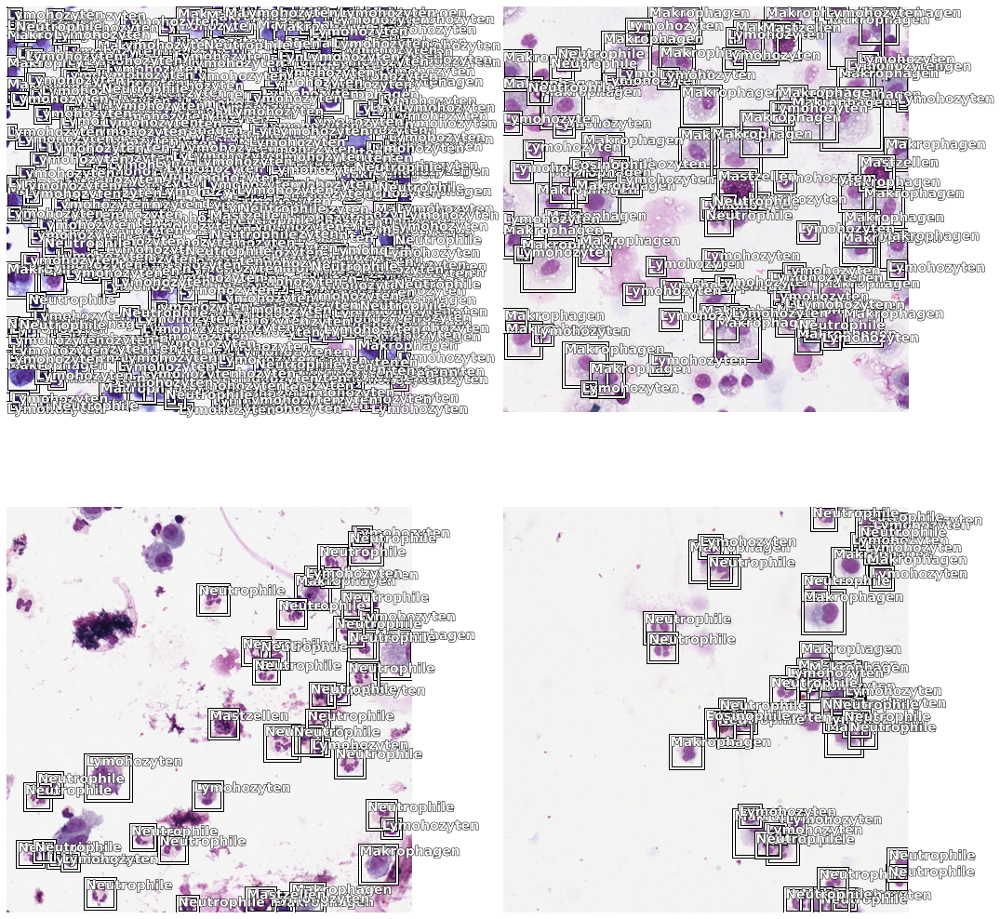

In [22]:
data.show_batch(rows=2, ds_type=DatasetType.Valid, figsize=(15,15))

In [23]:
scales = [.8, .9, 1, 1.1]
anchors = create_anchors(sizes=[(64, 64), (32,32)], ratios=[1], scales=scales)

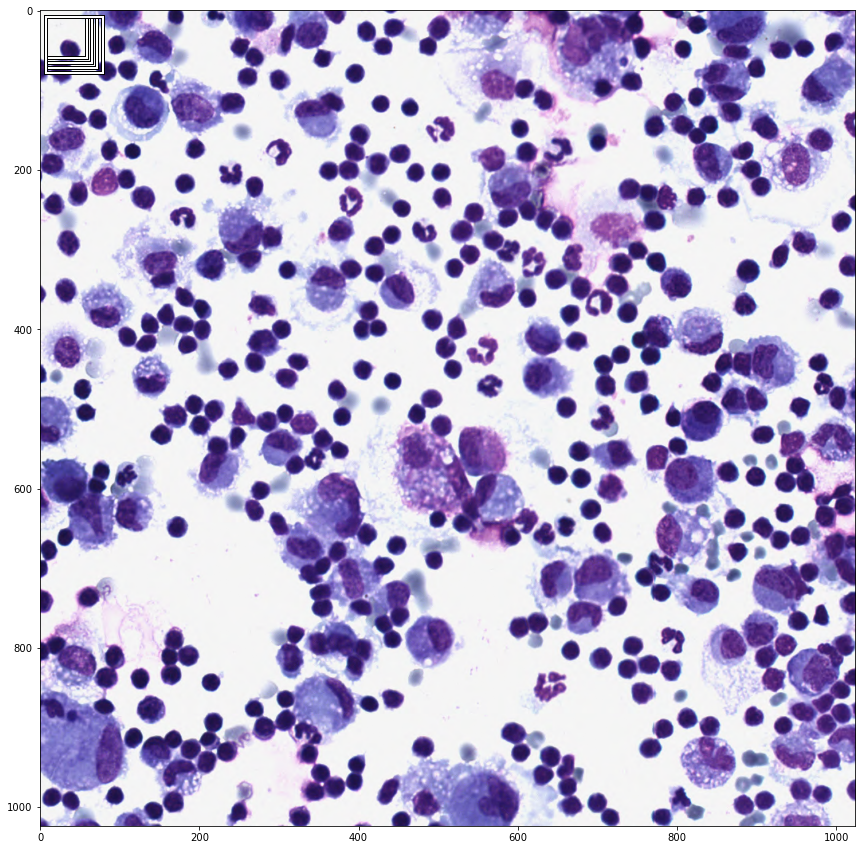

In [24]:
fig,ax = plt.subplots(figsize=(15,15))
ax.imshow(image2np(data.valid_ds[0][0].data))

for i, bbox in enumerate(anchors[:len(scales)]):
    bb = bbox.numpy()
    x = (bb[0] + 1) * size / 2 
    y = (bb[1] + 1) * size / 2 
    w = bb[2] * size / 2
    h = bb[3] * size / 2
    
    rect = [x,y,w,h]
    draw_rect(ax,rect)

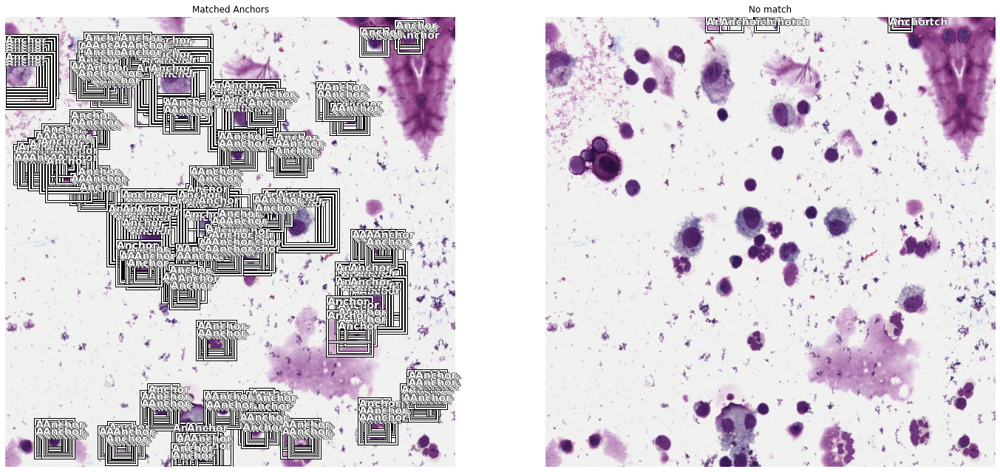

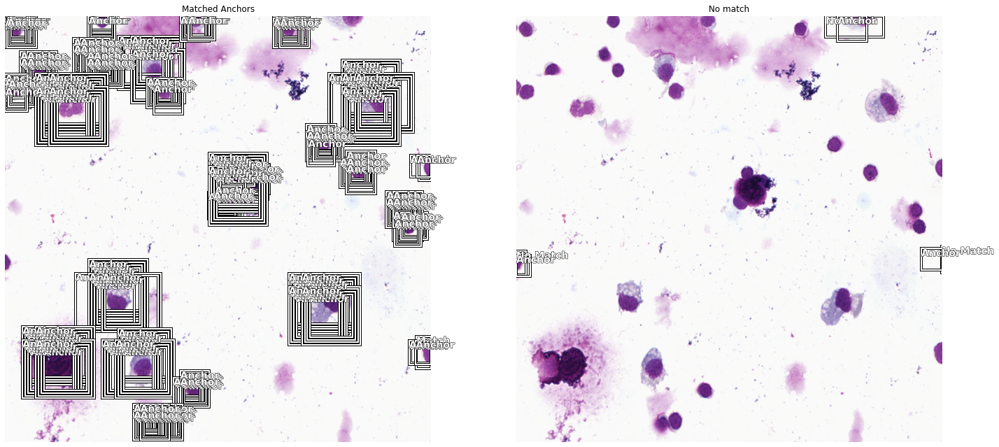

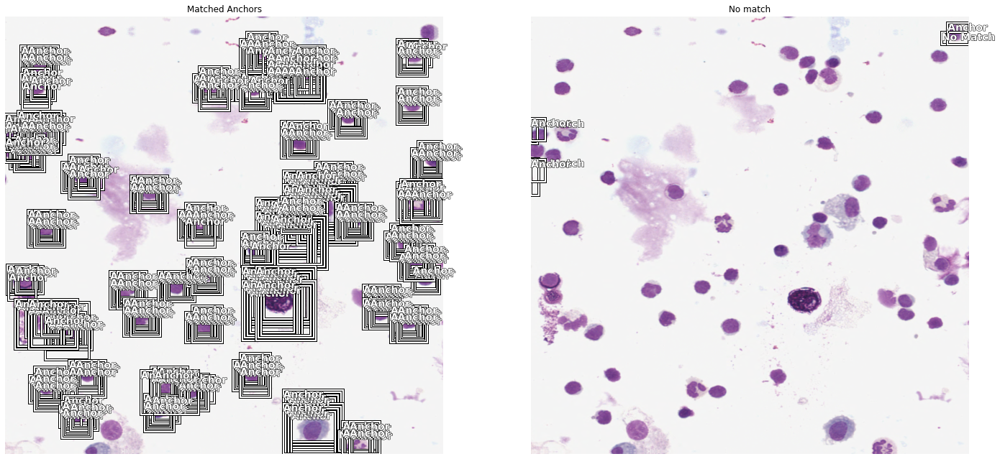

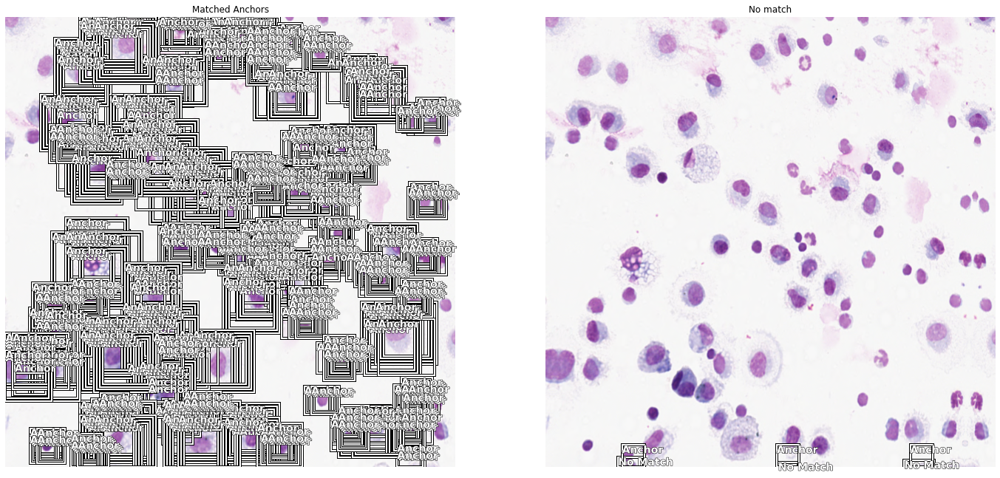

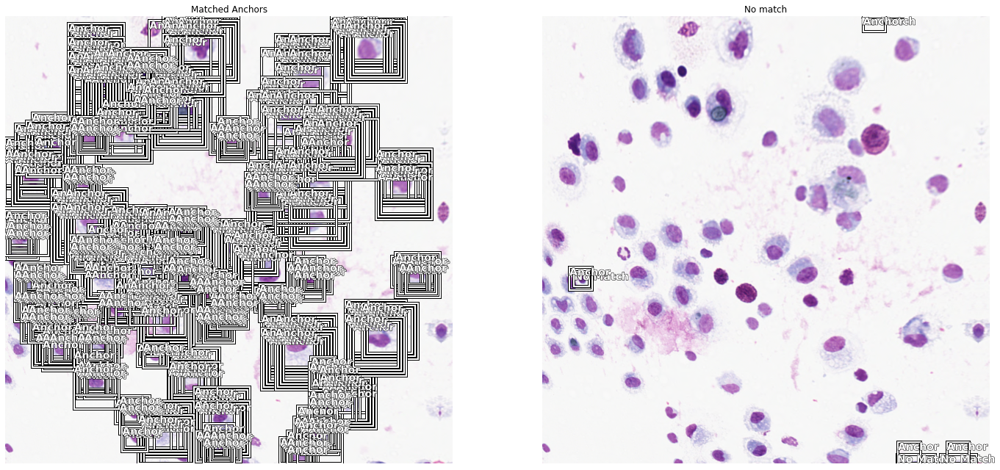

...

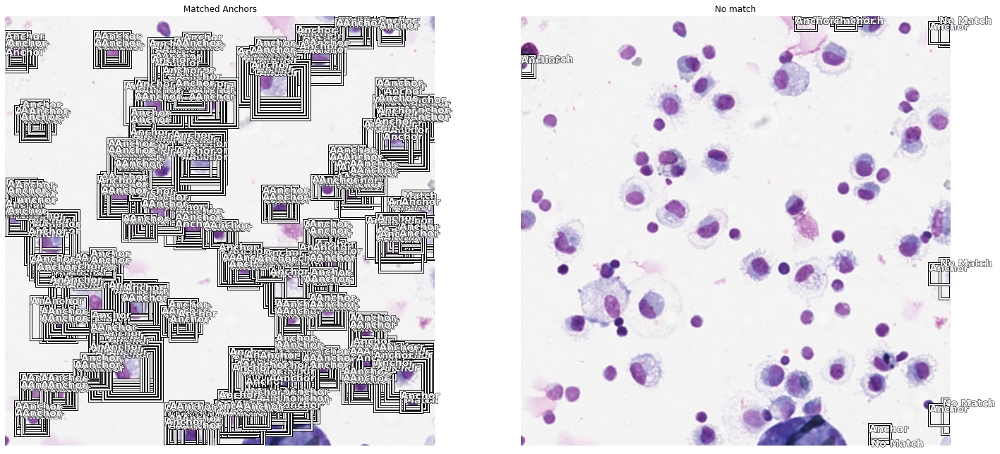

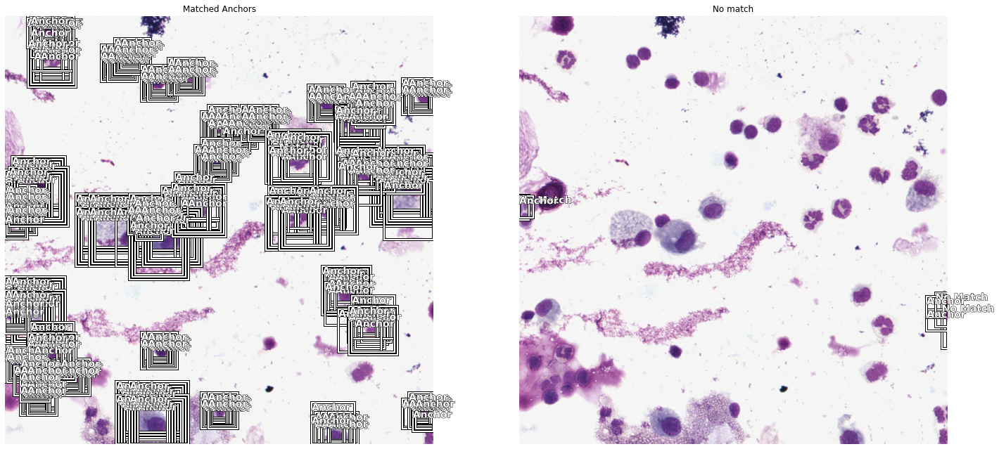

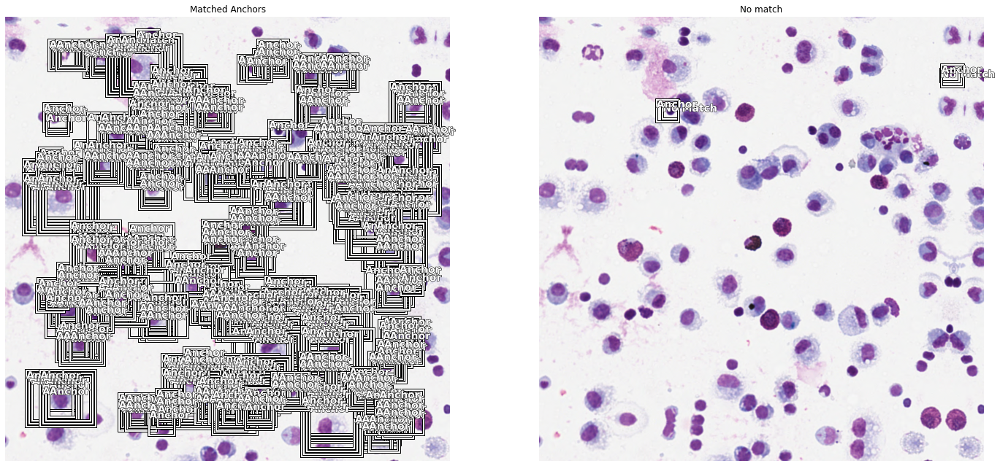

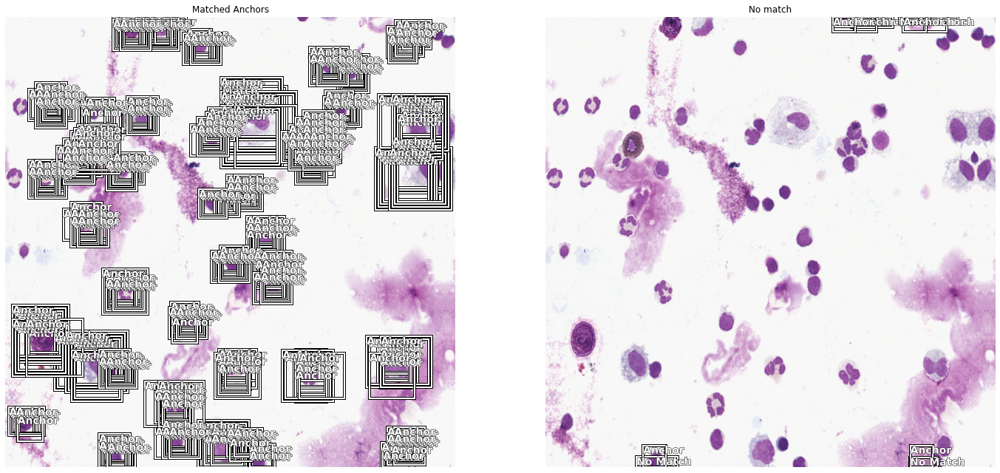

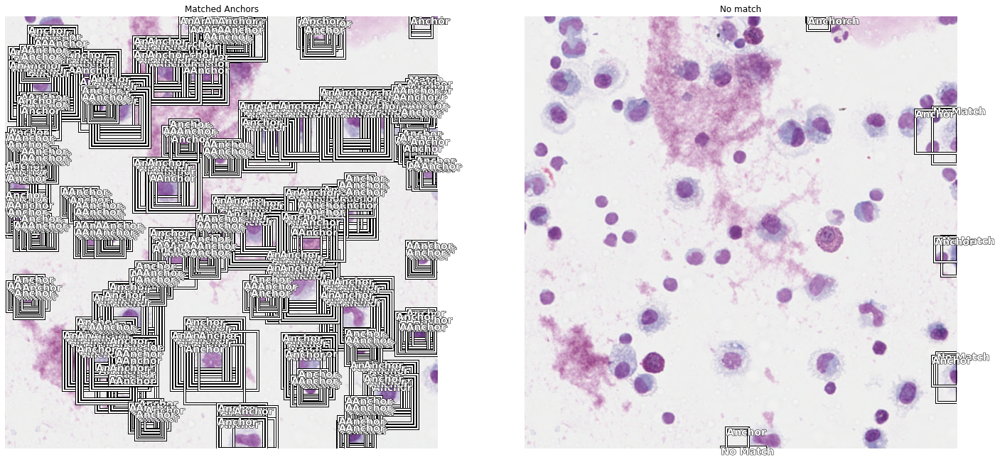

In [25]:
all_boxes, all_labels = show_anchors_on_images(data, anchors, figsize=(24, 24))

In [26]:
crit = RetinaNetFocalLoss(anchors)

encoder = create_body(models.resnet18, True, -2)
model = RetinaNet(encoder, n_classes=data.train_ds.c, n_anchors=len(scales), sizes=[64, 32], chs=128, final_bias=-4., n_conv=2)

In [27]:
data.train_ds.y.classes[1:]

['Eosinophile', 'Lymohozyten', 'Makrophagen', 'Mastzellen', 'Neutrophile']

In [28]:
voc = PascalVOCMetricByDistance(anchors, size, [str(i) for i in data.train_ds.y.classes[1:]], radius=40)
learn = Learner(data, model, loss_func=crit, callback_fns=[BBMetrics], #BBMetrics, ShowGraph
                metrics=[voc])

In [29]:
learn.split([model.encoder[6], model.c5top5])
learn.freeze_to(-2)

In [30]:
learn.fit_one_cycle(3, 1e-3)

epoch,train_loss,valid_loss,pascal_voc_metric_by_distance,BBloss,focal_loss,AP-Eosinophile,AP-Lymohozyten,AP-Makrophagen,AP-Mastzellen,AP-Neutrophile,time
0,1.275962,0.773612,0.322476,0.300584,0.473027,0.302060,0.241409,0.426817,0.277722,0.364375,11:36
1,0.695946,0.617394,0.399870,0.245457,0.371937,0.000000,0.450891,0.667145,0.365551,0.515762,14:06
2,0.485375,0.534581,0.410524,0.205447,0.329134,0.029586,0.450261,0.678357,0.354386,0.540032,13:50


In [31]:
learn.unfreeze()
learn.fit_one_cycle(10, 1e-3)

epoch,train_loss,valid_loss,pascal_voc_metric_by_distance,BBloss,focal_loss,AP-Eosinophile,AP-Lymohozyten,AP-Makrophagen,AP-Mastzellen,AP-Neutrophile,time
0,0.287916,0.539912,0.446387,0.177098,0.362814,0.143598,0.511266,0.663332,0.412638,0.501104,14:46
1,0.296233,0.646820,0.389897,0.182710,0.464110,0.305809,0.514087,0.411366,0.370238,0.347983,14:15
2,0.293030,0.510887,0.480154,0.163634,0.347252,0.541797,0.492587,0.681956,0.227599,0.456834,14:04
3,0.271449,0.483704,0.592471,0.146055,0.337649,0.631961,0.549528,0.671595,0.541833,0.567440,13:36
4,0.243999,0.439359,0.573806,0.144103,0.295256,0.545866,0.532335,0.656776,0.558540,0.575511,13:44
5,0.223258,0.454889,0.607098,0.157019,0.297870,0.525836,0.558743,0.702583,0.559727,0.688604,14:00
6,0.203095,0.315016,0.658707,0.104721,0.210295,0.650728,0.534721,0.744633,0.684176,0.679277,13:53
7,0.187504,0.332529,0.604527,0.116343,0.216186,0.518756,0.518997,0.714301,0.579213,0.691369,13:27
8,0.175172,0.321124,0.629796,0.110588,0.210536,0.574931,0.535493,0.741125,0.616500,0.680930,13:52
9,0.166247,0.332848,0.604700,0.108978,0.223870,0.503110,0.529630,0.718991,0.604982,0.666787,13:28


In [32]:
learn.fit_one_cycle(10, 1e-3)

epoch,train_loss,valid_loss,pascal_voc_metric_by_distance,BBloss,focal_loss,AP-Eosinophile,AP-Lymohozyten,AP-Makrophagen,AP-Mastzellen,AP-Neutrophile,time
0,0.154455,0.348902,0.591422,0.103264,0.245638,0.423263,0.558429,0.680523,0.661312,0.633583,13:51
1,0.167596,0.557432,0.619513,0.196013,0.361419,0.719259,0.566462,0.688674,0.578496,0.544672,14:08
2,0.197670,0.588310,0.552586,0.212299,0.376011,0.370411,0.446733,0.724208,0.473978,0.747598,12:45
3,0.213284,0.473390,0.541609,0.147250,0.326140,0.545476,0.461622,0.769632,0.385865,0.545451,13:29
4,0.203283,0.363709,0.636372,0.114147,0.249561,0.636693,0.487567,0.759490,0.646940,0.651170,13:11
5,0.190961,0.376999,0.567210,0.118211,0.258788,0.375364,0.525900,0.710030,0.544463,0.680296,14:02
6,0.176899,0.316789,0.650513,0.101954,0.214834,0.640472,0.514101,0.776858,0.699493,0.621640,12:54
7,0.162681,0.347498,0.621138,0.131017,0.216481,0.590580,0.499439,0.754533,0.596439,0.664699,12:56
8,0.153175,0.316335,0.614983,0.094903,0.221432,0.570829,0.527870,0.721298,0.611574,0.643345,13:56
9,0.147525,0.304391,0.614566,0.095095,0.209296,0.530371,0.511883,0.740590,0.618062,0.671922,13:08


In [33]:
learn.fit_one_cycle(10, 1e-3)

epoch,train_loss,valid_loss,pascal_voc_metric_by_distance,BBloss,focal_loss,AP-Eosinophile,AP-Lymohozyten,AP-Makrophagen,AP-Mastzellen,AP-Neutrophile,time
0,0.138801,0.331646,0.627908,0.106303,0.225343,0.692490,0.513297,0.737132,0.559779,0.636839,13:07
1,0.143439,0.488805,0.583203,0.220142,0.268663,0.543522,0.468374,0.732529,0.539006,0.632585,12:58
2,0.170600,0.531066,0.525517,0.147422,0.383643,0.126656,0.526343,0.756850,0.584904,0.632834,14:09
3,0.181914,0.400734,0.621001,0.120257,0.280477,0.680189,0.550382,0.668945,0.643890,0.561599,13:29
4,0.177138,0.350262,0.625195,0.122916,0.227346,0.721087,0.503966,0.730875,0.536232,0.633817,12:57
5,0.167534,0.346821,0.638153,0.124341,0.222479,0.714306,0.511663,0.714181,0.594085,0.656530,13:02
6,0.156788,0.317573,0.674162,0.107797,0.209776,0.783770,0.517782,0.720047,0.657173,0.692038,13:03
7,0.149935,0.283430,0.644115,0.088821,0.194608,0.733606,0.509450,0.730121,0.564540,0.682858,12:58
8,0.140392,0.307470,0.659122,0.098899,0.208571,0.733677,0.532135,0.725507,0.618864,0.685426,14:19
9,0.133811,0.297794,0.663275,0.095299,0.202495,0.778173,0.524721,0.725613,0.614601,0.673266,13:10


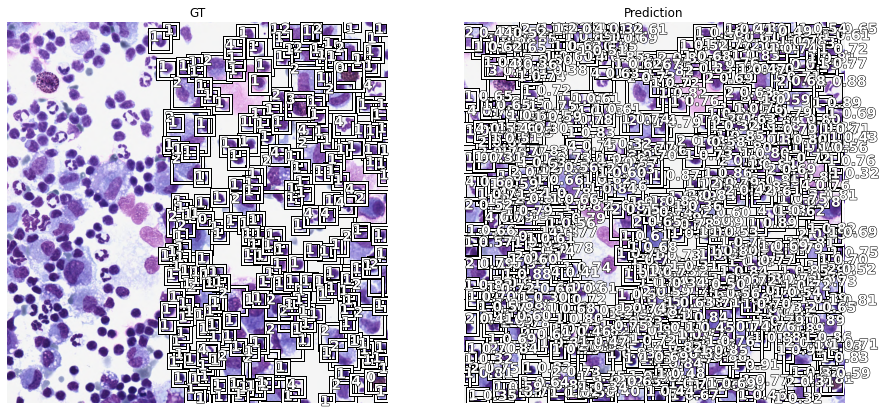

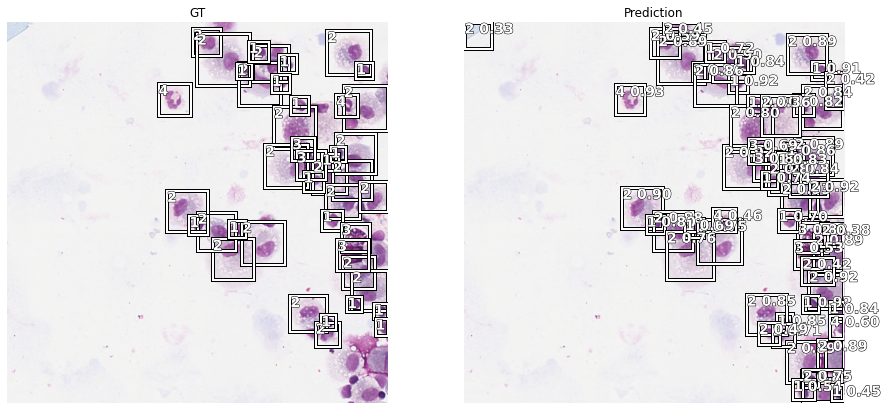

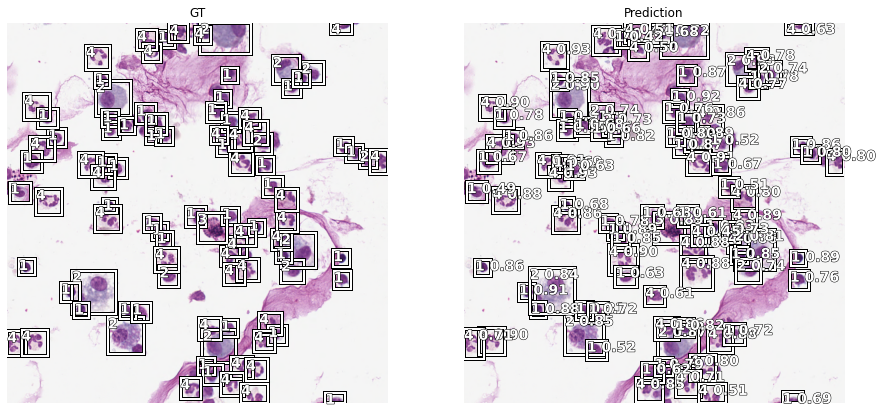

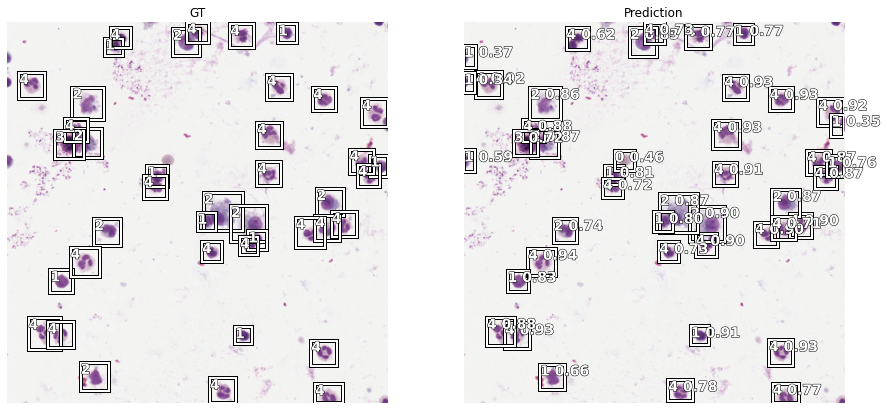

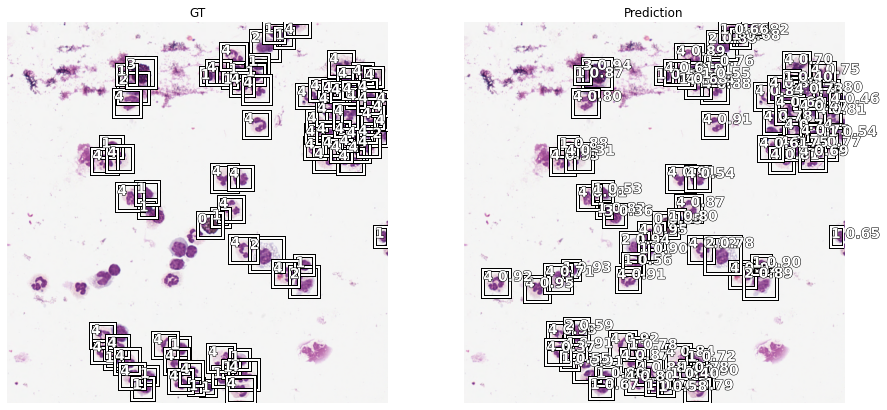

In [34]:
slide_object_result(learn, anchors, detect_thresh=0.3, nms_thresh=0.2)

In [35]:
data.c

6

In [41]:
import pickle

stats = {"anchors": anchors,
         "mean": to_np(data.stats[0]),
         "std": to_np(data.stats[1]),
         "size": size,
         "n_classes": data.c,
         "n_anchors": len(scales),
         "sizes": [64, 32],
         "chs": 128,
         "encoder": "RN-18",
         "n_conv": 2,
         "level": 0,
         "model": get_model(learn.model).state_dict()
        }

torch.save(stats, "{}.p".format(experiment_name))

In [37]:
data.classes 

['background',
 'Eosinophile',
 'Lymohozyten',
 'Makrophagen',
 'Mastzellen',
 'Neutrophile']

In [38]:
learn.fit_one_cycle(10, 1e-4)

epoch,train_loss,valid_loss,pascal_voc_metric_by_distance,BBloss,focal_loss,AP-Eosinophile,AP-Lymohozyten,AP-Makrophagen,AP-Mastzellen,AP-Neutrophile,time
0,0.129079,0.311972,0.635486,0.093663,0.218309,0.619100,0.521767,0.705507,0.655462,0.675593,14:21
1,0.126603,0.318002,0.660295,0.102981,0.215020,0.745158,0.535846,0.713983,0.630988,0.675503,13:46
2,0.127778,0.290483,0.658404,0.090097,0.200386,0.693413,0.517407,0.744457,0.629685,0.707056,13:20
3,0.127540,0.323256,0.648885,0.090479,0.232777,0.737486,0.525226,0.717771,0.635151,0.628793,13:02
4,0.126274,0.305764,0.656215,0.093793,0.211972,0.741633,0.528700,0.717476,0.606947,0.686319,13:58
5,0.125547,0.297598,0.650261,0.085781,0.211817,0.712279,0.536080,0.715963,0.620106,0.666880,13:27
6,0.122611,0.301739,0.651620,0.090593,0.211146,0.679046,0.515465,0.727705,0.657489,0.678393,12:58
7,0.122628,0.311814,0.652019,0.092751,0.219063,0.712344,0.526048,0.718937,0.624972,0.677796,13:33
8,0.122098,0.302750,0.646554,0.090500,0.212250,0.647140,0.535547,0.720791,0.649053,0.680239,13:26
9,0.122979,0.300542,0.657493,0.090361,0.210181,0.701993,0.532215,0.736750,0.627108,0.689400,13:15


In [39]:
learn.fit_one_cycle(10, 1e-4)

epoch,train_loss,valid_loss,pascal_voc_metric_by_distance,BBloss,focal_loss,AP-Eosinophile,AP-Lymohozyten,AP-Makrophagen,AP-Mastzellen,AP-Neutrophile,time
0,0.117735,0.313035,0.647608,0.090576,0.222458,0.708817,0.529434,0.702965,0.617633,0.679188,13:18
1,0.119006,0.314991,0.654475,0.092227,0.222764,0.732900,0.543351,0.701725,0.645832,0.648566,13:29
2,0.122124,0.329789,0.677845,0.109087,0.220703,0.765620,0.520122,0.722186,0.676968,0.704332,13:15
3,0.123104,0.290964,0.662322,0.092238,0.198726,0.751307,0.533586,0.730406,0.618643,0.677670,13:12
4,0.123143,0.303620,0.660895,0.091104,0.212516,0.748319,0.519188,0.710060,0.616842,0.710068,13:03
5,0.120617,0.319617,0.658641,0.099797,0.219820,0.778995,0.525624,0.712806,0.600614,0.675168,13:11
6,0.120586,0.292959,0.670503,0.090040,0.202919,0.777298,0.524646,0.726404,0.632764,0.691403,13:09
7,0.118824,0.279317,0.658919,0.085924,0.193393,0.728339,0.528720,0.714568,0.628023,0.694944,13:01
8,0.117716,0.292365,0.638370,0.087187,0.205178,0.672867,0.525215,0.728028,0.588876,0.676861,13:01
9,0.116912,0.301011,0.651920,0.088704,0.212307,0.726936,0.524255,0.715448,0.628337,0.664624,13:38


In [40]:
learn.fit_one_cycle(10, 1e-5)

epoch,train_loss,valid_loss,pascal_voc_metric_by_distance,BBloss,focal_loss,AP-Eosinophile,AP-Lymohozyten,AP-Makrophagen,AP-Mastzellen,AP-Neutrophile,time
0,0.117722,0.302586,0.628120,0.089032,0.213554,0.658494,0.516440,0.707061,0.588953,0.669650,13:14
1,0.117055,0.296703,0.653272,0.089293,0.207410,0.708513,0.525009,0.727056,0.612019,0.693761,13:17
2,0.116046,0.290821,0.657749,0.086213,0.204608,0.737111,0.521063,0.718079,0.625207,0.687285,13:29
3,0.116022,0.293026,0.668678,0.089520,0.203506,0.788083,0.519483,0.719193,0.625195,0.691436,13:31
4,0.117572,0.302570,0.648775,0.089290,0.213281,0.712675,0.518360,0.708506,0.611867,0.692469,12:45
5,0.117052,0.304587,0.651743,0.091430,0.213157,0.728595,0.518647,0.715099,0.617587,0.678788,13:12
6,0.116646,0.295643,0.657839,0.088627,0.207017,0.745969,0.524820,0.720789,0.611535,0.686082,13:04
7,0.117370,0.294323,0.657350,0.089680,0.204644,0.751753,0.523904,0.723743,0.602199,0.685149,13:04
8,0.115999,0.298205,0.654571,0.088413,0.209792,0.738849,0.528551,0.716458,0.611010,0.677987,13:08
9,0.116501,0.303670,0.647468,0.089148,0.214522,0.691916,0.519415,0.711892,0.623275,0.690842,13:04
